In [1]:
using QuantumToolbox
using SparseArrays
using PlotlyJS
using Arpack
using IterTools

In [2]:
# # can't be autoreloaded
# include("basic_codes.jl")
# using .basic_codes

In [81]:
function get_liouvillian(N::Int, Delta::Real, G::Real, tg::Real, k1::Real, kphi::Real)
    """
    Constructs the Liouvillian superoperator from a Hamiltonian and a set of collapse operators.
    
    Parameters:
    H (Operator): The Hamiltonian of the system.
    c_ops (Vector{Operator}): A vector of collapse operators.
    
    Returns:
    Liouvillian: The Liouvillian superoperator.
    """
    # define operators
    a = destroy(N)
    ad = create(N)

    # adjust Parameters
    U = tg/sqrt(1+tg^2)
    k2 = 1/sqrt(1+tg^2)
   
    # Construct the Hamiltonian
    H = Delta*ad*a + G/2*(ad^2+a^2) - U/2*(ad^2*a^2)

    # collapse operators
    c_ops = [sqrt(k2)*a^2, sqrt(k1)*a, sqrt(kphi)*ad*a]
    
    # Construct the Liouvillian
    L = liouvillian(H, c_ops)

    return L, a, ad
end;

# function to plot the wigner function
function plot_wigner(rho,xx,yy)
    layout = Layout(
        xaxis_title="Re(β)",
        yaxis_title="Im(β)",
        title="Wigner function",
        width=500,
        height=500
    )
    
    w = wigner(rho, xx, yy);
    vbound = maximum(abs.(w))

    custom_colorscale = [
        [0, "blue"],   # Negative values to blue
        [0.5, "white"],  # Zero values to white
        [1, "red"],     # Positive values to red
    ]

    heatmap_trace = heatmap(
        z=w,
        x=xx,
        y=yy,
        colorscale=custom_colorscale,
        showscale=true,
        zmin = -vbound,
        zmax = vbound
    )

    plot(heatmap_trace, layout)
end;

# fix the size of the vector which has support only in one block 
function completevec(vec, nblock, P, block_indices, block_sizes; unvectorize=true, retQobj=true, tosparse=true)
    # make a (possibly sparse) vector the correct size of the full system
    v = tosparse ? sparse(zeros(ComplexF64,(sum(block_sizes),1))) : zeros(ComplexF64,(sum(block_sizes),1))

    # put the vector in the correct block (the rest is zero)
    v[block_indices[nblock]:block_indices[nblock]+block_sizes[nblock]-1] = vec

    # apply the conjugate permutation to revert into original basis
    v = P'*v

    # depending on vectorization/qobj, return the correct vector
    if retQobj
        v = unvectorize ? QuantumObject(reshape(v, (N,N))) : QuantumObject(v)
    else
        v = unvectorize ? reshape(v, (N,N)) : v
    end
    return v
end

# get the lowest lying states and values from the different symmetry sectors
function get_lowlying(N::Int, G::Real, Delta::Real, tg::Real, k1::Real, kphi::Real, nev::Int, sigma::Real, nvecs=2, left=false)
    # Get the Liouvillian
    L, a, ad  = get_liouvillian(N, Delta, G, tg, k1, kphi)
    # Get the block diagonal form of the Liouvillian with bdf function
    if left
        P, Lbd, block_sizes = bdf(Qobj(L'))
    else
        P, Lbd, block_sizes = bdf(L)
    end

    block_list, block_indices = get_bdf_blocks(Lbd,block_sizes)

    # set up the lists for the eigenvalues and eigenvectors
    ρl = []
    Λl = Vector{ComplexF64}[]

    # adjust the number of eigenvalues to be calculated
    nev = maximum([nev, nvecs])

    # loop over all blocks (either 2 or 4 depending on k1)
    for nblock in 1:length(block_list)
        evals, evecs = eigs(block_list[nblock],  nev=nev, sigma=sigma) # diagonalize sparse matrix
        args         = sortperm(abs.(real.(evals))) # permuation of sorted eigenvalues
        evals, evecs = evals[args], evecs[:,args]

        Λ = evals[1:nvecs]
        ρ = collect(eachcol(evecs[:,1:nvecs])) # take only first nvecs eigenvectors and change to array

        ρ = map(x->completevec(x, nblock, P, block_indices, block_sizes; unvectorize=true), ρ) # make the vectors the correct size and unvectorize them
        ρ = map(x-> abs(tr(x))>0.1 ? x/tr(x)  : x/x.data[x.data.!=0][1], ρ) # normalize the vectors (density matrices)
        ρ = map(x-> abs(tr(x))>0.1 ? (x+x')/2 : x+x' , ρ)

        # append the values to the return lists
        push!(ρl,ρ)
        push!(Λl,Λ)
    end
    return Λl, ρl
end;

# spectral decomposition function
function spectral_decomposition(ρ)
    # warning if trace is not 0
    matrix_trace = tr(ρ)
    if abs(matrix_trace)>1e-10
        print("Warning: trace of input matrix $matrix_trace is not zero", )
    end
    # spectral decomposition
    ri,ψi = eigen(ρ)
    
    # separate positive and negative eigenvalues (guaranteed to be real if ρ is hermitian)
    cp = real(ri).>0
    cm = real(ri).<0

    # arrays of positive and negative eigenvalues and eigenvectors
    ep = ri[cp]
    em = ri[cm]
    vp = ψi[cp]
    vm = ψi[cm]
    
    # initialize density matrices
    ρp = ep[1]*ket2dm(QuantumObject(vp[1]))
    ρm = em[1]*ket2dm(QuantumObject(vm[1]))
    
    # loop over positive space projectors
    for i in 2:length(ep)
        p = ep[i]
        v = vp[i]
        ρp += p*ket2dm(QuantumObject(v))
    end
    
    # loop over negative space projectors
    for i in 2:length(em)
        p = em[i]
        v = vm[i]
        ρm += -p*ket2dm(QuantumObject(v))
    end
    
    # normalize
    ρm = ρm/tr(ρm)
    ρp = ρp/tr(ρp)

    return ρp, ρm
end;

function spectral_decomposition_bis(rho) # seems to work better than the previous one
    # simple spectral decomposition
    es, sts = eigen(rho)

    iplus = findall(x->real(x)>0, es)
    iminus = findall(x->real(x)<0, es)

    rho_p = sum(es[i] * sts[:][i] * sts[:][i]' for i in iplus)
    rho_m = sum(-es[i] * sts[:][i] * sts[:][i]' for i in iminus)

    rho_p /= tr(rho_p)
    rho_m /= tr(rho_m)

    return rho_p, rho_m
end;

# Initial tests

In [8]:
N = 40
Delta = 0.
G = 5.
tg = 1e2*0
k1 = 1e-3
kphi = 1e-5

nev = 30
sigma = 1e-7

L, a, ad = get_liouvillian(N, Delta, G, tg, k1, kphi);

In [9]:
# get the eigenvalues of the Liouvillian
spectrum, states = eigenstates(L);

┌ Warning: attempting to remove probably stale pidfile
│   path = /Users/leo/.jlassetregistry.lock
└ @ Pidfile /Users/leo/.julia/packages/Pidfile/DDu3M/src/Pidfile.jl:260


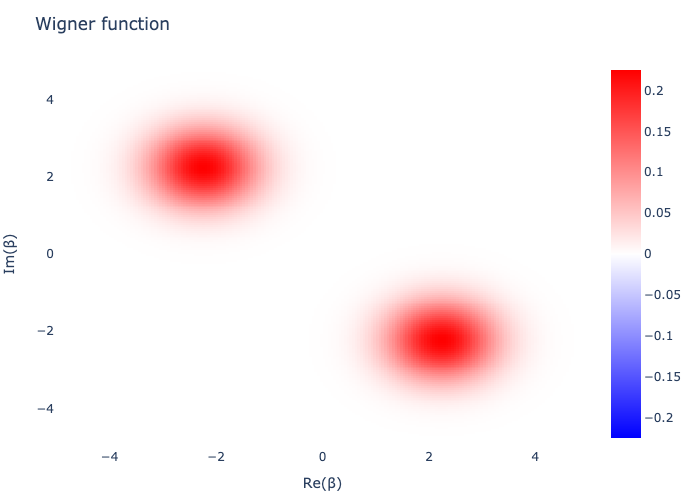

In [10]:
xvec = range(-5, 5, length=200)
plot_wigner(vec2mat(states[end]), xvec, xvec)

# Encoding states

## $\Delta = 0$

In [16]:
# set parameters
N = 90
Δ0 = 0.
G = 5.
tg = 1e5 # not sure about this one
k1 = 1e-3
kphi = 1e-5

nev = 30
sigma = 1e-7;

In [17]:
rates, states = get_lowlying(N, G, Δ0, tg, k1, kphi, nev, sigma);
ρ0p = states[1][1]
ρ1p = states[1][2]
ρ0m = states[2][1]
ρ1m = states[2][2];

┌ Warning: attempting to remove probably stale pidfile
│   path = /Users/leo/.jlassetregistry.lock
└ @ Pidfile /Users/leo/.julia/packages/Pidfile/DDu3M/src/Pidfile.jl:260


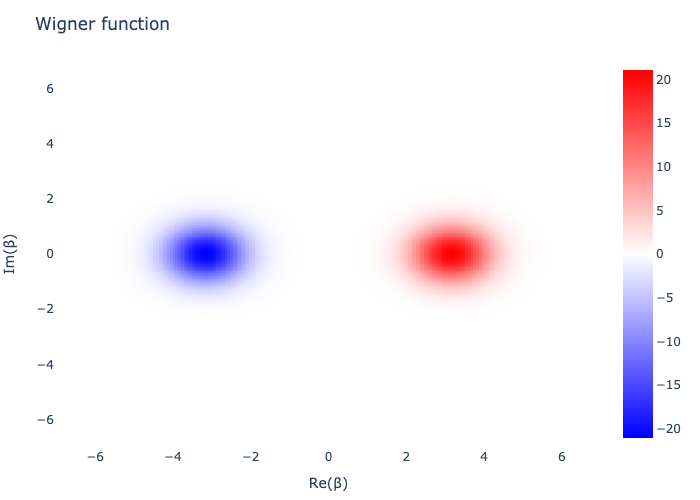

In [18]:
xvec = range(-7, 7, length=200)
plot_wigner(ρ0m, xvec, xvec)

Looks great.

In [19]:
ρ0mp, ρ0mm = spectral_decomposition_bis(ρ0m);

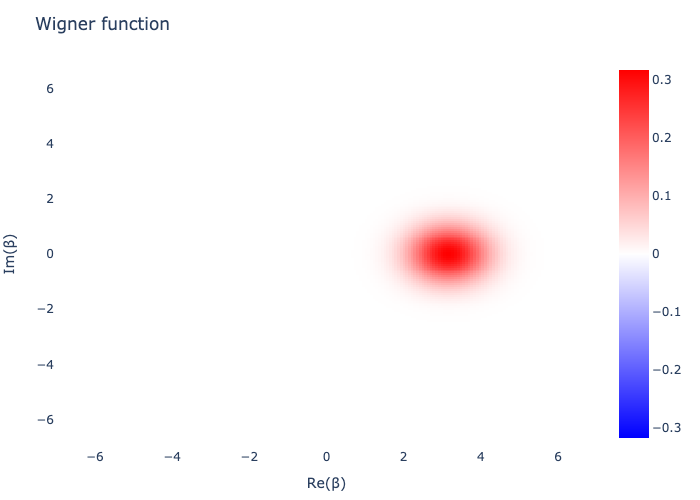

In [20]:
plot_wigner(ρ0mp, xvec, xvec)

## $\Delta > 0$

In [21]:
# set parameters
Δb = 5;

In [22]:
rates, states = get_lowlying(N, G, Δb, tg, k1, kphi, nev, sigma);
ρ0p_b = states[1][1]
ρ1p_b = states[1][2]
ρ0m_b = states[2][1]
ρ1m_b = states[2][2];

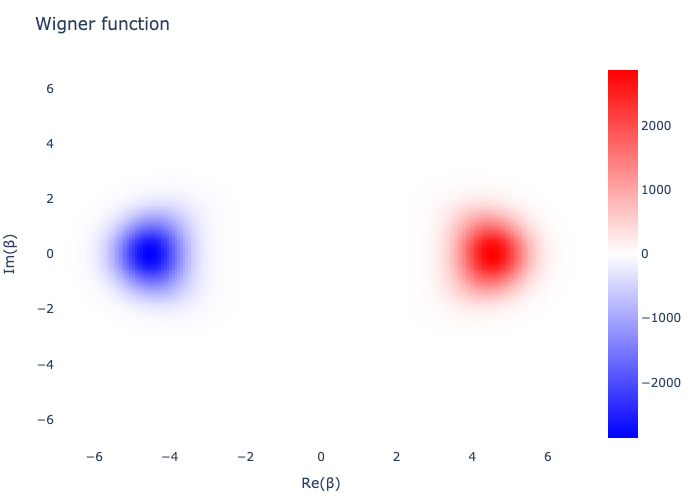

In [23]:
plot_wigner(ρ0m_b, xvec, xvec)

In [24]:
ρ0mp_b, ρ0mm_b = spectral_decomposition_bis(ρ0m_b);

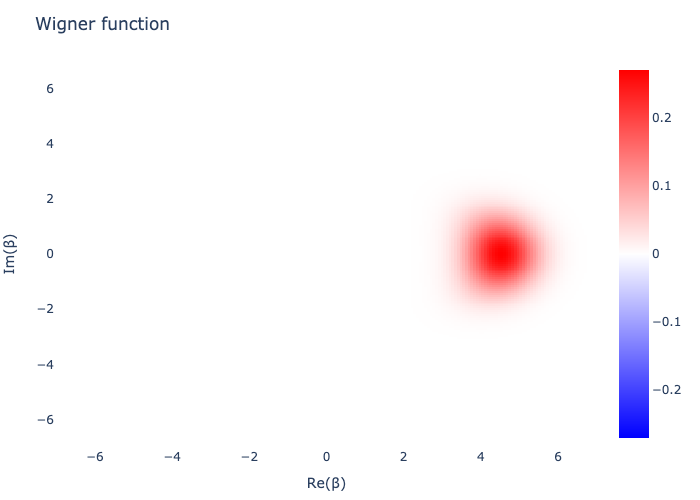

In [25]:
plot_wigner(ρ0mp_b, xvec, xvec)

## $\Delta > \Delta_c$

In [26]:
# set parameters
Δc = 25;

In [27]:
rates, states = get_lowlying(N, G, Δc, tg, k1, kphi, nev, sigma);
ρ0p_c = states[1][1]
ρ1p_c = states[1][2]
ρ0m_c = states[2][1]
ρ1m_c = states[2][2];

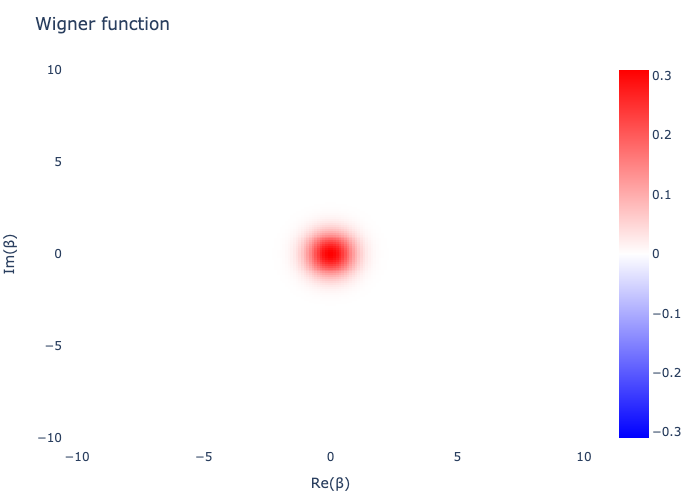

In [28]:
plot_wigner(ρ0p_c, xvec.*1.5, xvec.*1.5) # steady state is now a squeezed vacuum state

Steady state is now a squeezed vacuum state. It cannot serve as the centre of the Bloch sphere and define the desired logical basis. This is  *a priori* problematic because it means that our code states, which previously had theoretically finite lifetime due to being encoded in the steady state, will now only be metastable with lifetime $\Lambda^{-1}$ where $\Lambda$ is the rate of whichever state we define to be the Bloch sphere centre. 

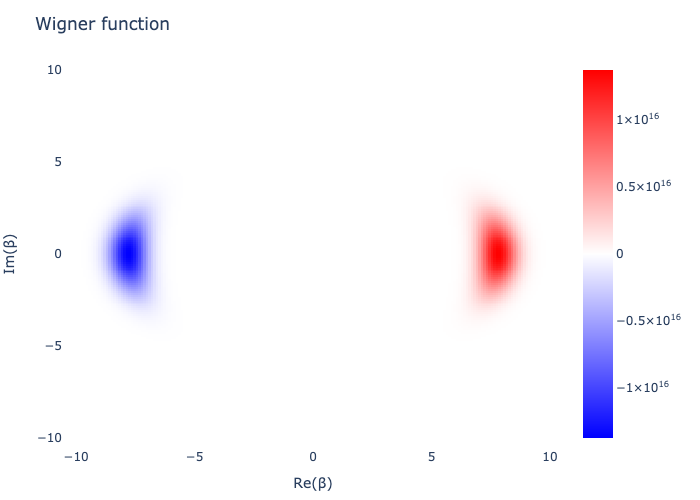

In [29]:
plot_wigner(ρ0m_c, xvec.*1.5, xvec.*1.5)

$\rho_0^-$ is unchanged.

Look for the new Bloch sphere centre in excited diagonal states.

In [30]:
# new center of bloch sphere is in the first excited state
ρ1pp_c, ρ1pm_c = spectral_decomposition_bis(ρ1p_c);

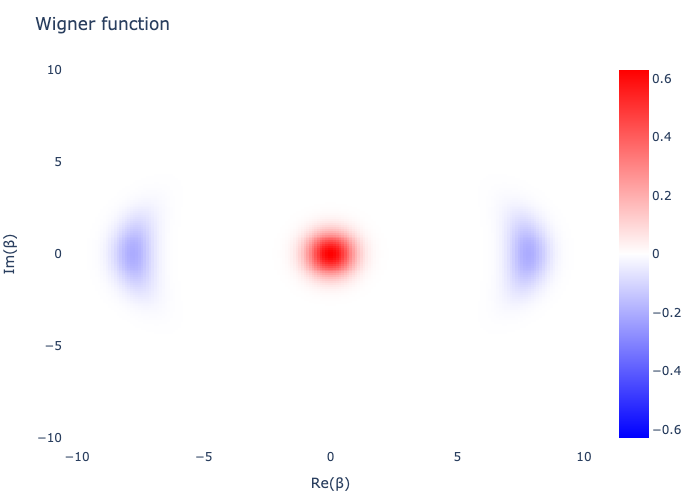

In [31]:
plot_wigner(ρ1p_c, xvec.*1.5, xvec.*1.5) # made up of steady state and bloch sphere center

$\rho_1^+$ is made up of the vacuum state (which we know to be the steady state) and the identity. We can decompose it to find the Bloch sphere centre.

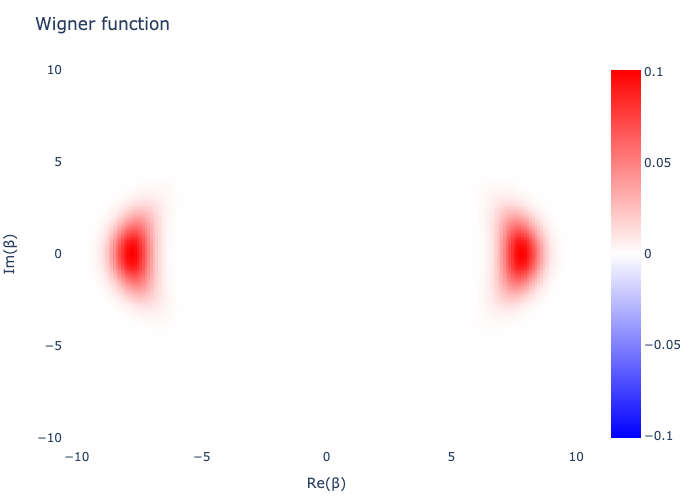

In [32]:
plot_wigner(ρ1pm_c, xvec.*1.5, xvec.*1.5)

This looks a lot like the identity we previously had in other regimes of $\Delta$. Difference being, of course, that states initialized on the bloch sphere will decay towards the steady state at a rate $\Gamma_{leak} = \Lambda_1^+$. 

# Spectral weights $\langle \sigma | \rho \rangle$

In [198]:
N = 50
Δ = 5.
Δc = 25.
G = 5.
tg = 1e5
k1 = 1e-3
kphi = 1e-5

nev = 30
sigma = 1e-7

# make the Liouvillian
L, a, ad = get_liouvillian(N, Δ, G, tg, k1, kphi);

In [199]:
# get left eigenvectors of Liouvillian

# block diagonalize the Liouvillian
P, Lbd, block_sizes = bdf(L)
block_list, block_indices = get_bdf_blocks(Lbd,block_sizes);

# make lists to store the eigenvectors and eigenvalues
λll, vll = [], []

# loop over blocks
for i in 1:length(block_list)
    # get the right eigenvectors and eigenvalues
    λl, vr = eigen(Matrix(block_list[i]), sortby = x -> -real(x)) # note the hermitian

    # convert into left eigenvectors
    vl = inv(vr)'

    # completevec on each column to get the correct size
    f = vv -> completevec(vv, i, P, block_indices, block_sizes, unvectorize=false, retQobj=false, tosparse=false)
    push!(vll, mapreduce(f, hcat, eachcol(vl)))
    push!(λll, λl)
end

In [200]:
# put them all into one matrix
vll = hcat(vll...)
λll = hcat(λll...) # still has two dimensions instead of just list


args = sortperm(abs.(real(vec(λll))))
vll = vll[:,args]
λll = λll[args];


In [201]:
# array of left eigenvectors
λl, vl = λll[1:end], vll[:,1:end];

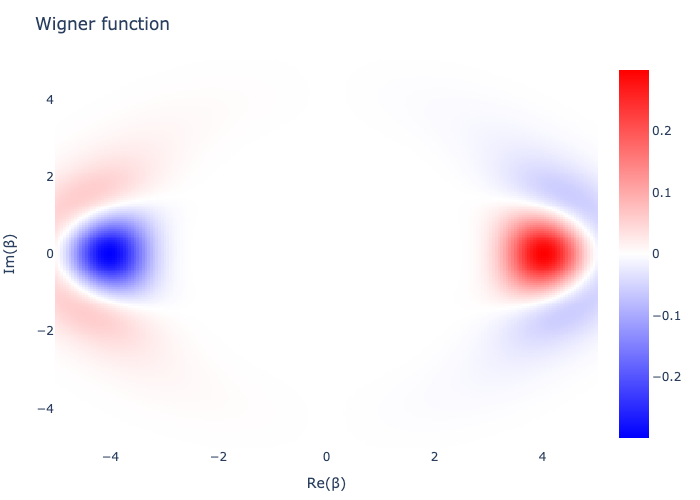

In [202]:
# what do the left eigenvectors look like?
xvec = range(-5, 5, length=200)
plot_wigner(Qobj(vec2mat(vl[:,3])), xvec, xvec)

In [205]:
# get the right eigenoperator of interest
rates, ρs = get_lowlying(N, G, Δ, tg, k1, kphi, nev, sigma)
ρ0m_c = ρs[2][1]

ρ0mp_c, ρ0mm_c = spectral_decomposition_bis(ρ0m_c);
v = vec(ρ0mm_c.data)
O = abs.(map(s->abs(s'*v/(norm(s')*norm(v))), eachcol(vll)));

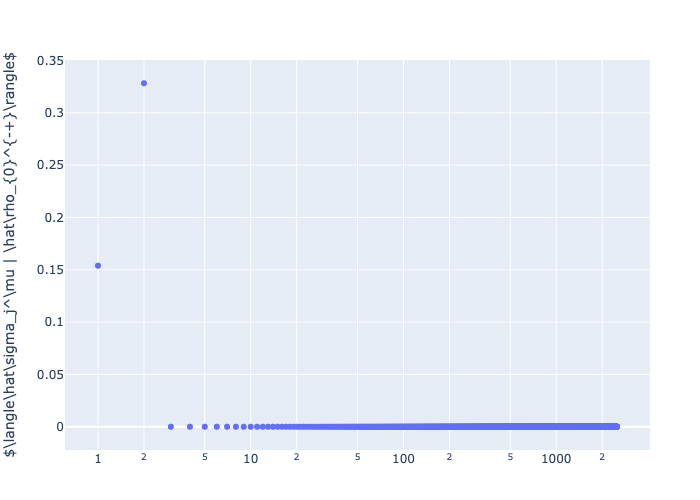

In [206]:
scatter_plot = scatter(x=collect(1:length(O)),y=O, mode="markers")

layout = Layout(
    yaxis_title=raw"$\langle\hat\sigma_j^\mu | \hat\rho_{0}^{-+}\rangle$",
    xaxis_type="log"
)

plot(scatter_plot, layout)

There are only two nonvanishing overlaps at $\Delta < \Delta_c$. When $\Delta$ is larger, however:

In [208]:
# make the liouvillian
L, a, ad = get_liouvillian(N, Δc, G, tg, k1, kphi);

In [209]:
# get left eigenvectors of Liouvillian

# block diagonalize the Liouvillian
P, Lbd, block_sizes = bdf(L)
block_list, block_indices = get_bdf_blocks(Lbd,block_sizes);

# make lists to store the eigenvectors and eigenvalues
λll, vll = [], []

# loop over blocks
for i in 1:length(block_list)
    # get the right eigenvectors and eigenvalues
    λl, vr = eigen(Matrix(block_list[i]), sortby = x -> -real(x)) # note the hermitian

    # convert into left eigenvectors
    vl = inv(vr)'

    # completevec on each column to get the correct size
    f = vv -> completevec(vv, i, P, block_indices, block_sizes, unvectorize=false, retQobj=false, tosparse=false)
    push!(vll, mapreduce(f, hcat, eachcol(vl)))
    push!(λll, λl)
end

# put them all into one matrix
vll = hcat(vll...)
λll = hcat(λll...) # still has two dimensions instead of just list


args = sortperm(abs.(real(vec(λll))))
vll = vll[:,args]
λll = λll[args];

# array of left eigenvectors
λl, vl = λll[1:end], vll[:,1:end];

In [210]:
# get the right eigenoperator of interest
rates, ρs = get_lowlying(N, G, Δc, tg, k1, kphi, nev, sigma)
ρ0m_c = ρs[2][1]

ρ0mp_c, ρ0mm_c = spectral_decomposition_bis(ρ0m_c);
v = vec(ρ0mm_c.data)
O = abs.(map(s->abs(s'*v/(norm(s')*norm(v))), eachcol(vll)));

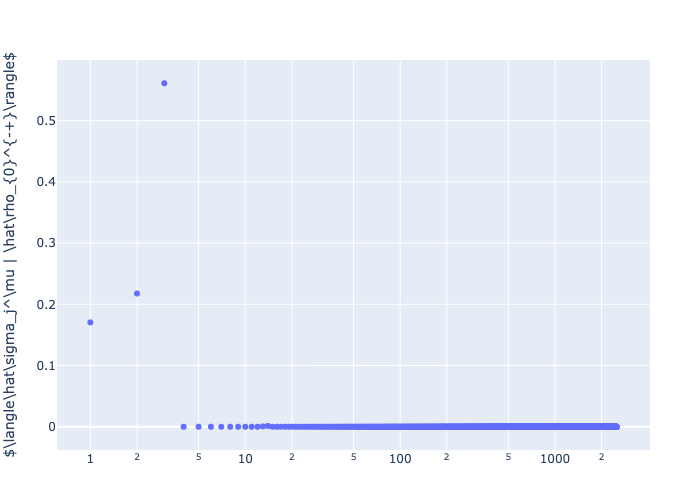

In [211]:
scatter_plot = scatter(x=collect(1:length(O)),y=O, mode="markers")

layout = Layout(
    yaxis_title=raw"$\langle\hat\sigma_j^\mu | \hat\rho_{0}^{-+}\rangle$",
    xaxis_type="log"
)

plot(scatter_plot, layout)

Now there are three nonvanishing overlaps due to the leakage $\Gamma_{\mathrm{leak}}$ from the current center of the bloch sphere $\rho_1 (+)$ towards the steady state $\rho_{ss} = |n=0><n=0|$, outside of the code space. 

# Order parameter 

How does $\langle a^{\dagger}a\rangle$ change as a function of $\Delta$?

In [129]:
# expectation values
N = 90 # only go to high N if using sparse matrices
nev = 30
sigma = 1e-7

G = 5.
tg = 1e5
k1 = 1e-3
kphi = 1e-5

res = 200
Deltas = range(0,30,length=res)
expval, expval_p, expval_m = [], [], []

for i in 1:res
    # set Delta
    Δ = Deltas[i]
    # get liouvillian
    L, a, ad = get_liouvillian(N, Δ, tg, k1, kphi)
    # get the states of interest
    rates, ρs = get_lowlying(N, G, Δ, tg, k1, kphi, nev, sigma)
    # get the steady state
    ρss = ρs[1][1]
    # get the rho_1_+ density matrices
    ρ1p = ρs[1][2]
    # decompose it
    ρ1p_p, ρ1p_m = spectral_decomposition_bis(ρ1p)
    # compute expectation values of the number operator
    push!(expval, real(expect(ad*a,ρss)))
    push!(expval_m, real(expect(ad*a,ρ1p_m)))
    push!(expval_p, real(expect(ad*a,ρ1p_p)))
end

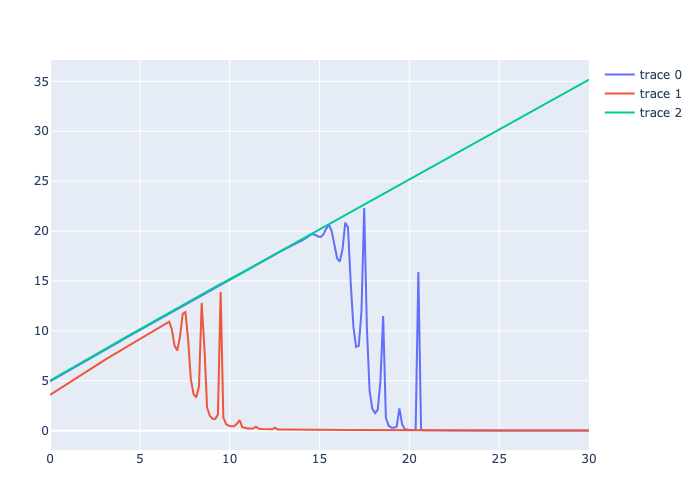

In [130]:
op_plot = scatter(x=Deltas,y=expval)
op_plot_p = scatter(x=Deltas,y=expval_p)
op_plot_m = scatter(x=Deltas,y=expval_m)

# make appropriate layout
layout = Layout(
    yaxis_title="<a^{dagger}a>",
    xaxis_title="Δ",
    width=500,
    height=500
)

plot([op_plot,op_plot_p, op_plot_m])

This looks like the result in the paper. This means that the state decomposition is working well now.

The expectation value of the destruction operator, $<a>$, does not change as a function of $\Delta$. But what about $\sqrt{<a^2>} = \alpha$?

In [122]:
# expectation values
N = 90 # only go to high N if using sparse matrices
nev = 30
sigma = 1e-7

G = 5.
tg = 1e5
k1 = 1e-3
kphi = 1e-5

res = 200
Deltas = range(0,30,length=res)
expval, expval_p, expval_m = [], [], []

for i in 1:res
    # set Delta
    Δ = Deltas[i]
    # get liouvillian
    L, a, ad = get_liouvillian(N, Δ, tg, k1, kphi)
    # get the states of interest
    rates, ρs = get_lowlying(N, G, Δ, tg, k1, kphi, nev, sigma)
    # get the steady state
    ρss = ρs[1][1]
    # get the rho_1_+ density matrices
    ρ1p = ρs[1][2]
    # decompose it
    ρ1p_p, ρ1p_m = spectral_decomposition_bis(ρ1p)
    # compute expectation values of the number operator
    push!(expval, real(sqrt(expect(a^2,ρss))))
    push!(expval_m, real(sqrt(expect(a^2,ρ1p_m))))
    push!(expval_p, real(sqrt(expect(a^2,ρ1p_p))))
end

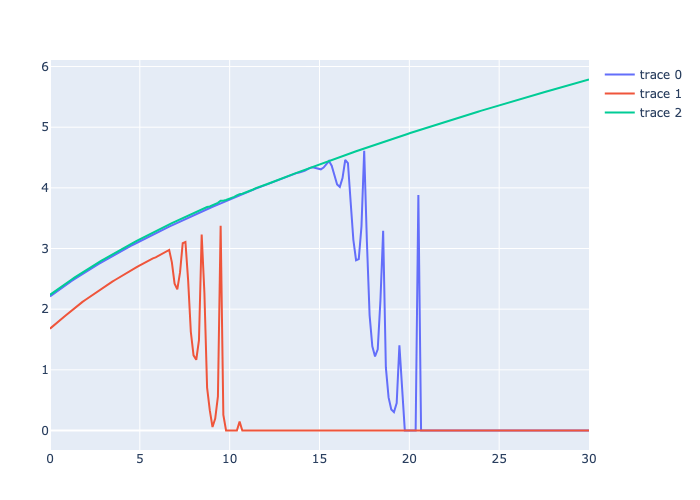

In [128]:
op_plot = scatter(x=Deltas,y=expval)
op_plot_p = scatter(x=Deltas,y=expval_p)
op_plot_m = scatter(x=Deltas,y=expval_m)

layout = Layout(
    yaxis_title="<a^{dagger}a>",
    xaxis_title="Δ",
    width=500,
    height=500,
)


plot([op_plot,op_plot_p, op_plot_m])

Looks very similar, with a slight curve. Shouldn't be surprising because $n$ can be thought of as $\alpha^2$. This is just the square root of the plot above, and signifies that, at the transition, the steady state goes from being a superposition of the logical states (with $\alpha \neq 0 $) to being the vacuum state ()

# Bias-preserving gates

In [65]:
# set the parameters for this section
N = 40
Δ = 0.
G = 5
tg = 1e5*0
k1 = 1e-5
kphi = 1e-3

a = destroy(N)
ad = create(N);

In [38]:
# define the parity super operator
parity = expm(1im*pi*ad*a);
parity_super = sprepost(parity,parity'); # superoperator

Quantum Object:   type=SuperOperator   dims=[40]   size=(1600, 1600)
1600×1600 SparseMatrixCSC{ComplexF64, Int64} with 1600 stored entries:
⎡⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎤
⎢⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⎥
⎣⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⎦

In [97]:
# check: positive parity should become negative parity after one cycle, t = T = pi/4FRe(α)

# after a time T = pi / 4FRe(α), the cat state should have rotated to the negative parity cat state
α = sqrt(G)
ρ0 = normalize(coherent(N,α)+coherent(N,-α))
F = 0.1
Hdrive = F*(ad+a)
T = pi / (4 * F * real(α))
tlist = range(0, T, length=1000)
# liouvillian is simple cat liouvillian
result = mesolve(liouvillian(Hdrive,[a^2-α^2*qeye(N)]), ρ0, tlist, [], e_ops=[parity])
expectation_values = real(result.expect);


Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)


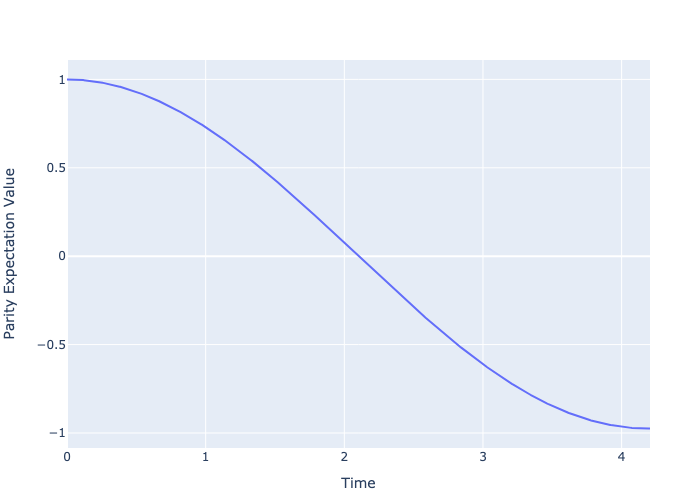

In [98]:
plot_trace = scatter(x=collect(tlist), y=expectation_values[1,:], mode="lines")

layout = Layout(
    xaxis_title="Time",
    yaxis_title="Parity Expectation Value"
)

plot(plot_trace, layout)

In [94]:
# calculate error probability
pz_basic = (expectation_values[end] + 1)/2 # i'm surprised it's this high

0.012414457725599126

This reaches $-1$ at the desired time $T$.

Now for the full $\mathcal{L}$:

In [116]:
# now, use full liouvillian
N = 40
Δ = 0.
G = 5
tg = 1e5*0
k1 = 1e-5
kphi = 1e-3

# be careful with alpha, it is not necessarily the same as before
α = sqrt(1im*G)
ρ0 = normalize(coherent(N,α)+coherent(N,-α))
F = 0.1
Hdrive = F*(ad+a)
T = pi / (4 * F * real(α))
tlist = range(0, T, length=1000)
# liouvillian is full liouvillian
L = get_liouvillian(N, Δ, G, tg, k1, kphi)[1] + liouvillian(Hdrive)
result = mesolve(L, ρ0, tlist, [], e_ops=[parity])
expectation_values = real(result.expect);

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)


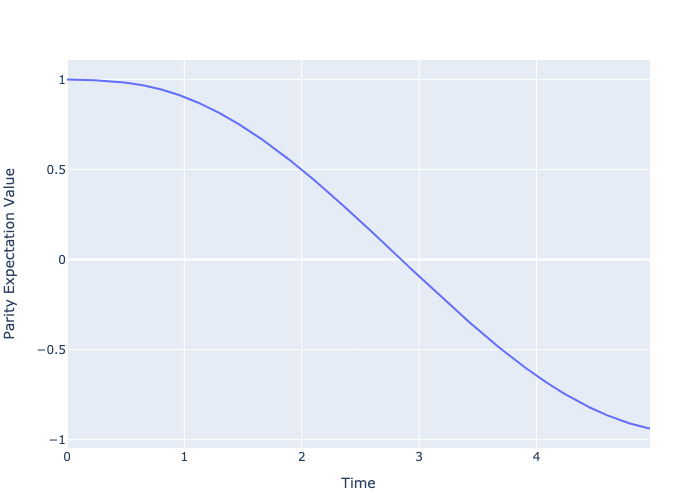

In [117]:
plot_trace = scatter(x=collect(tlist), y=expectation_values[1,:], mode="lines")

layout = Layout(
    xaxis_title="Time",
    yaxis_title="Parity Expectation Value"
)

plot(plot_trace, layout)

In [110]:
# calculate error probability
pz_full = (expectation_values[end] + 1)/2

0.030667952733481108

We see that it does not reach $-1$ for the expected time due to the errors. Note that we have to make $\alpha^2 = iG$ because this is prescribed by the fact that $G$ is real.

Now we will loop over different values of $T$ and allow for $\alpha$ (and consequently, $G$) to vary.

In [118]:
# loop over different T values
T_values = range(0.1, 5, length=100)
pz_values = zeros(length(T_values)) # the value of the parity at the end of the run

for (i, T) in enumerate(T_values)
    # set alpha and calculate G
    G = 2 * pi^2 / (4*F*T)^2
    α = sqrt(1im*G)
    # calculate Liouvillian
    L = get_liouvillian(N, Δ, G, tg, k1, kphi)[1] + liouvillian(Hdrive)
    ρ0 = normalize(coherent(N, α) + coherent(N, -α)) # not a density matrix but mesolve does not care
    result = mesolve(L, ρ0, collect(range(0,T, length=100)), [], e_ops=[parity]);
    parity_expect = real(result.expect)
    pz_values[i] = parity_expect[end]
end

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 04s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 01s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 01s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [===================

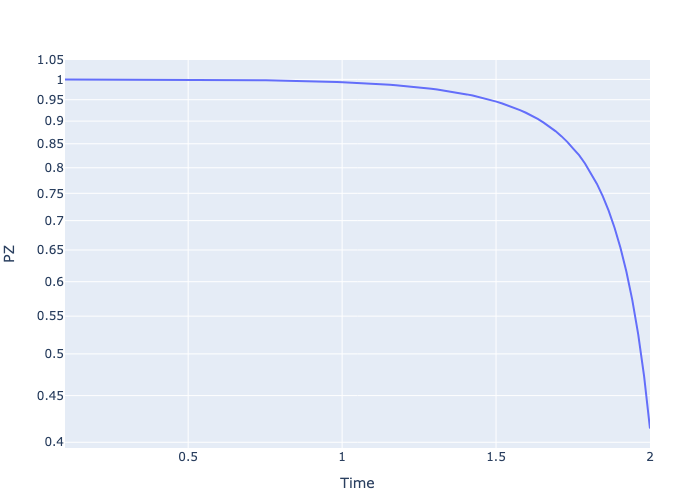

In [113]:
plot_trace = scatter(x=T_values, y=pz_values, mode="lines")

# make y axis log scale
layout = Layout(
    yaxis_type="log",
    yaxis_title="PZ",
    xaxis_title="Time"
)

plot(plot_trace, layout)